In [13]:
import torch
from torch import nn
import torchvision
from torchvision.datasets import Cityscapes
from torch.utils.data.sampler import SubsetRandomSampler
import random
import matplotlib.pyplot as plt
from tqdm import tqdm
import torchvision.transforms as T
import os
from torch.utils.tensorboard import SummaryWriter
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import numpy as np

In [37]:
class CustomCityscapesLoader(Dataset):
    def __init__(self, image_dir, label_dir, transform=None, target_transform=None):
        """
        Args:
            image_dir (str): 图像文件的目录路径。
            label_dir (str): 标签文件的目录路径。
            transform (callable, optional): 应用于图像的变换。
            target_transform (callable, optional): 应用于标签的变换。
        """
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.transform = transform
        self.target_transform = target_transform

        # 图像和标签文件名匹配
        self.image_files = sorted(os.listdir(image_dir))
        self.label_files = sorted(os.listdir(label_dir))

        assert len(self.image_files) == len(self.label_files), "图像和标签数量不匹配！"

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        # 加载图像和标签
        img_path = os.path.join(self.image_dir, self.image_files[idx])
        label_path = os.path.join(self.label_dir, self.label_files[idx])

        image = Image.open(img_path).convert("RGB")
        label = Image.open(label_path)

        # 应用变换
        if self.transform:
            image = self.transform(image)
        if self.target_transform:
            label = self.target_transform(label)

        return image, label

def datasets():
    # 数据增强设置
    transform = T.Compose([
        T.Resize((224, 224)),
        T.ToTensor(),
        T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])
    target_transform = T.Compose([
        T.Resize((224, 224), interpolation=Image.NEAREST),  # 保持最近邻插值
        T.ToTensor(),  # 转换为 PyTorch 张量
        # lambda x: x.long()  # 确保标签为整数类型
    ])

    # 数据集路径
    root_dir = "./dataset"  # 替换为实际路径
    train_image_dir = os.path.join(root_dir, "image/cityscapes_train")
    val_image_dir = os.path.join(root_dir, "image/cityscapes_val")
    test_image_dir = os.path.join(root_dir, "image/cityscapes_test")

    train_label_dir = os.path.join(root_dir, "label/cityscapes_19classes_train")
    val_label_dir = os.path.join(root_dir, "label/cityscapes_19classes_val")
    test_label_dir = os.path.join(root_dir, "label/cityscapes_19classes_test")

    # 实例化数据集
    train_dataset = CustomCityscapesLoader(train_image_dir, train_label_dir, transform, target_transform)
    val_dataset = CustomCityscapesLoader(val_image_dir, val_label_dir, transform, target_transform)
    test_dataset = CustomCityscapesLoader(test_image_dir, test_label_dir, transform, target_transform)

    # 创建 DataLoader
    # # 获取 1/4 的索引
    # subset_size = len(train_dataset) // 64
    # subset_size2 = len(val_dataset) // 20
    # subset_indices = random.sample(range(len(train_dataset)), subset_size)
    # subset_indices2 = random.sample(range(len(val_dataset)), subset_size)
    # # 创建一个 SubsetRandomSampler，传入上述索引
    # sampler = SubsetRandomSampler(subset_indices)
    # sampler2 = SubsetRandomSampler(subset_indices2)
    #
    # train_loader = DataLoader(train_dataset, batch_size=4, sampler=sampler)
    # val_loader = DataLoader(val_dataset, batch_size=4, sampler=sampler2)

    train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=2)
    val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, num_workers=2)
    test_loader = DataLoader(test_dataset, batch_size=4, shuffle=False, num_workers=2)
    return train_loader,val_loader,test_loader
train_loader,val_loader,test_loader = datasets()

(224, 224, 3) torch.Size([1, 224, 224])
Targets max: 255.0, second max: 13.0
(224, 224, 3) torch.Size([1, 224, 224])
Targets max: 255.0, second max: 18.0
(224, 224, 3) torch.Size([1, 224, 224])
Targets max: 255.0, second max: 18.0
(224, 224, 3) torch.Size([1, 224, 224])
Targets max: 255.0, second max: 18.0


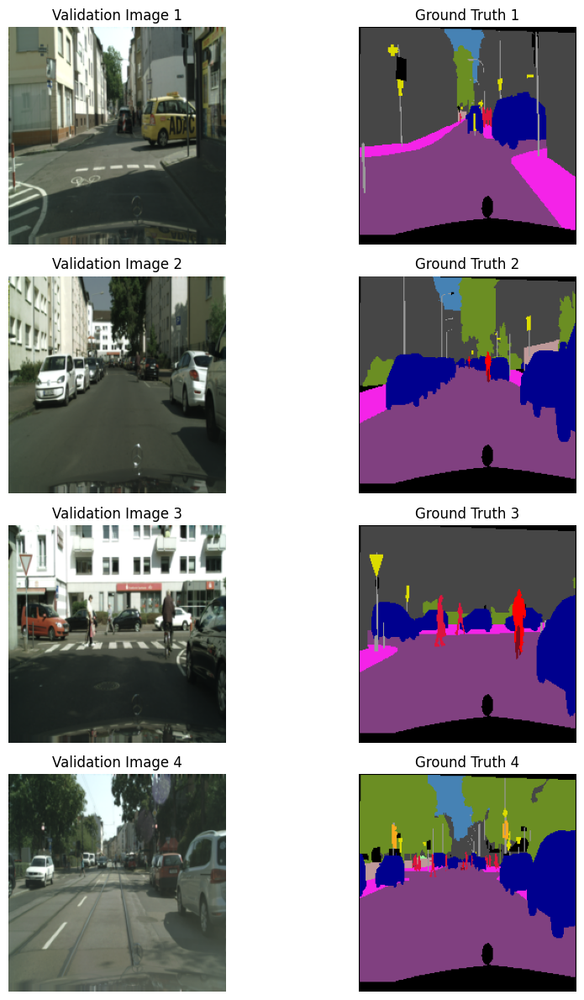

In [38]:
# Cityscapes 类别和颜色
cityscapes_colors = [
    (128, 64, 128),   # 道路
    (244, 35, 232),   # 人行道
    (70, 70, 70),     # 建筑物
    (102, 102, 156),  # 墙壁
    (190, 153, 153),  # 栅栏
    (153, 153, 153),  # 灯杆
    (250, 170, 30),   # 信号灯
    (220, 220, 0),    # 标志牌
    (107, 142, 35),   # 树木
    (152, 251, 152),  # 地形
    (70, 130, 180),   # 天空
    (220, 20, 60),    # 人
    (255, 0, 0),      # 骑行者
    (0, 0, 142),      # 汽车
    (0, 0, 70),       # 卡车
    (0, 60, 100),     # 公交车
    (0, 80, 100),     # 火车
    (0, 0, 230),      # 摩托车
    (119, 11, 32),    # 自行车
]

def map_to_color(label_map, color_map):
    """
    将类别索引映射为颜色。
    Args:
        label_map: (H, W) 类别索引图
        color_map: List of (R, G, B) tuples
    Returns:
        RGB 图像 (H, W, 3)
    """
    height, width = label_map.shape
    color_image = np.zeros((height, width, 3), dtype=np.uint8)
    for label, color in enumerate(color_map):
        color_image[label_map == label] = color
    return color_image

# 获取一个批次的数据
images, labels = next(iter(val_loader))
# 可视化真实分割标签
def visualize_segmentation(images, labels, num_images=4):
    fig, axes = plt.subplots(num_images, 2, figsize=(10, num_images * 3))
    for i in range(num_images):
        # 显示原始图像
        img = images[i].permute(1, 2, 0)  # 将通道从 (C, H, W) 转为 (H, W, C)
        img = img * torch.tensor([0.229, 0.224, 0.225]) + torch.tensor([0.485, 0.456, 0.406])  # 去标准化
        img = img.numpy().clip(0, 1)

        print(img.shape,labels[i].shape)
        axes[i, 0].imshow(img)
        axes[i, 0].set_title(f"Validation Image {i+1}")
        axes[i, 0].axis("off")

        # 显示真实标签
        label = (labels[i]*255).squeeze().numpy()
        # print(label)
        flattened_targets = torch.unique((labels[i]*255).squeeze().flatten())

        sorted_targets, _ = torch.sort(flattened_targets, descending=True)

        # 获取第二大的值
        second_max = sorted_targets[1].item() if len(sorted_targets) > 1 else None

        print(f"Targets max: {sorted_targets[0].item()}, second max: {second_max}")
        label = map_to_color(label, cityscapes_colors)
        axes[i, 1].imshow(label)
        axes[i, 1].set_title(f"Ground Truth {i+1}")
        axes[i, 1].axis("off")


    plt.tight_layout()
    plt.show()

# 调用可视化函数
visualize_segmentation(images, labels)

In [16]:
class DINOv2(nn.Module):
    """Use DINOv2 pre-trained models
    """

    def __init__(self, version='small', is_pretrain = True,freeze=False, load_from=None):
        super().__init__()

        BACKBONE_SIZE = version # in ("small", "base", "large" or "giant")
        backbone_archs = {
            "small": "vits14",
            "base": "vitb14",
            "large": "vitl14",
        }
        backbone_arch = backbone_archs[BACKBONE_SIZE]
        backbone_name = f"dinov2_{backbone_arch}"

        # self.dinov2 = torch.hub.load('facebookresearch/dinov2', backbone_name)
        self.dinov2 = torch.hub.load('DINOv2', backbone_name, source='local', pretrained=is_pretrain)
        if load_from is not None:
            d = torch.load(load_from, map_location='cpu')
            new_d = {}
            for key, value in d.items():
                if 'pretrained' in key:
                    new_d[key.replace('pretrained.', '')] = value
            self.dinov2.load_state_dict(new_d)

        self.freeze = freeze

    def forward(self, inputs):
        B, _, h, w = inputs.shape

        if self.freeze:
            with torch.no_grad():
                features = self.dinov2.get_intermediate_layers(inputs, 4)
        else:
            features = self.dinov2.get_intermediate_layers(inputs, 4)

        outs = []
        for i,feature in enumerate(features):
            C = feature.shape[-1]
            feature = feature.permute(0, 2, 1).reshape(B, C, h // 14, w // 14).contiguous()
            outs.append(feature)

        return outs

class SegmentationHead(nn.Module):
    def __init__(self, in_channels, num_classes,target_shape = (1024,2048)):
        super(SegmentationHead, self).__init__()
        self.seg_head = nn.Sequential(
            nn.Conv2d(in_channels, num_classes, kernel_size=3, padding=1),
            # nn.Conv2d(in_channels, num_classes, kernel_size=1),
            nn.Upsample(target_shape, mode='bilinear', align_corners=False)
        )

    def forward(self, x):
        return self.seg_head(x)

class PPM(nn.ModuleList):
    def __init__(self, pool_sizes, in_channels, out_channels):
        super(PPM, self).__init__()
        self.pool_sizes = pool_sizes
        self.in_channels = in_channels
        self.out_channels = out_channels
        for pool_size in pool_sizes:
            self.append(
                nn.Sequential(
                    nn.AdaptiveMaxPool2d(pool_size),
                    nn.Conv2d(self.in_channels, self.out_channels, kernel_size=1),
                )
            )

    def forward(self, x):
        # print(f"Before pooling: {x.shape}")
        out_puts = []
        for ppm in self:
            ppm_out = nn.functional.interpolate(ppm(x), size=(x.size(2), x.size(3)), mode='bilinear', align_corners=True)
            out_puts.append(ppm_out)
        return out_puts

class PPMHEAD(nn.Module):
    def __init__(self, in_channels, out_channels, pool_sizes = [1, 2, 3, 6],num_classes=31):
        super(PPMHEAD, self).__init__()
        self.pool_sizes = pool_sizes
        self.num_classes = num_classes
        self.in_channels = in_channels
        self.out_channels = out_channels
        self.psp_modules = PPM(self.pool_sizes, self.in_channels, self.out_channels)
        self.final = nn.Sequential(
            nn.Conv2d(self.in_channels + len(self.pool_sizes)*self.out_channels, self.out_channels, kernel_size=1),
            nn.BatchNorm2d(self.out_channels),
            nn.ReLU(),
        )

    def forward(self, x):
        out = self.psp_modules(x)
        out.append(x)
        out = torch.cat(out, 1)
        # print(f" out: {out.shape}")
        out = self.final(out)
        return out

class FPNHEAD(nn.Module):
    def __init__(self, channels=384, out_channels=256):
        super(FPNHEAD, self).__init__()
        self.PPMHead = PPMHEAD(in_channels=channels, out_channels=out_channels)

        self.Conv_fuse1 = nn.Sequential(
            nn.Conv2d(channels, out_channels, 1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.Conv_fuse1_ = nn.Sequential(
            nn.Conv2d(out_channels, out_channels, 1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.Conv_fuse2 = nn.Sequential(
            nn.Conv2d(channels, out_channels, 1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.Conv_fuse2_ = nn.Sequential(
            nn.Conv2d(out_channels, out_channels, 1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

        self.Conv_fuse3 = nn.Sequential(
            nn.Conv2d(channels, out_channels, 1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.Conv_fuse3_ = nn.Sequential(
            nn.Conv2d(out_channels, out_channels, 1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

        self.fuse_all = nn.Sequential(
            nn.Conv2d(out_channels*4, out_channels, 1),  # 最终输出 num_classes 通道
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.conv_x1 = nn.Conv2d(out_channels, out_channels, 1)
    def forward(self, input_fpn):
        x1 = self.PPMHead(input_fpn[-1])

        x = nn.functional.interpolate(x1, size=(x1.size(2)*2, x1.size(3)*2), mode='bilinear', align_corners=True)
        x_ = nn.functional.interpolate(input_fpn[-2], size=(x1.size(2)*2, x1.size(3)*2), mode='bilinear', align_corners=True)
        x = self.conv_x1(x) + self.Conv_fuse1(x_)
        x2 = self.Conv_fuse1_(x)

        x = nn.functional.interpolate(x2, size=(x2.size(2)*2, x2.size(3)*2), mode='bilinear', align_corners=True)
        x_ = nn.functional.interpolate(input_fpn[-3], size=(x2.size(2)*2, x2.size(3)*2), mode='bilinear', align_corners=True)

        x = x + self.Conv_fuse2(x_)

        x3 = self.Conv_fuse2_(x)

        x = nn.functional.interpolate(x3, size=(x3.size(2)*2, x3.size(3)*2), mode='bilinear', align_corners=True)
        x_ = nn.functional.interpolate(input_fpn[-4], size=(x3.size(2)*2, x3.size(3)*2), mode='bilinear', align_corners=True)

        x = x + self.Conv_fuse3(x_)
        x4 = self.Conv_fuse3_(x)


        x1 = nn.functional.interpolate(x1, x4.size()[-2:], mode='bilinear', align_corners=True)
        x2 = nn.functional.interpolate(x2, x4.size()[-2:], mode='bilinear', align_corners=True)
        x3 = nn.functional.interpolate(x3, x4.size()[-2:], mode='bilinear', align_corners=True)

        x = self.fuse_all(torch.cat([x1, x2, x3, x4], 1))

        return x

class DINOv2SegmentationModel(nn.Module):
    def __init__(self, version='small', num_classes=21, pretrained=True):
        super(DINOv2SegmentationModel, self).__init__()
        self.backbone = DINOv2(version=version, freeze=True, is_pretrain=True)
        self.FPN = FPNHEAD(channels=384, out_channels=256)  # 替换为 FPNHEAD
        self.segmentation_head = SegmentationHead(in_channels=256, num_classes=num_classes,target_shape = (224,224))  # 1024 可根据 DINOv2 输出通道数调整

    def forward(self, x):
        # 获取多尺度特征
        features = self.backbone(x)
        # 将多尺度特征传递给分割头
        FPN_feature = self.FPN(features)

        segmentation_output = self.segmentation_head(FPN_feature)

        return segmentation_output

In [36]:
# 通用评估函数
def evaluate(model, loader, criterion, device, phase="validation", num_classes=20,save_path  = None):
    model.eval()
    running_loss = 0.0
    correct = 0
    total = 0
    predictions, targets_list, images_list = [], [], []

    with torch.no_grad():
        progress_bar = tqdm(loader, desc=f"{phase.capitalize()} Phase", leave=False, dynamic_ncols=True)
        for images, targets in progress_bar:
            images, targets = images.to(device), targets.squeeze(1).to(device)
            targets = (targets*255).long()

            outputs = model(images)
            loss = criterion(outputs, targets)
            running_loss += loss.item() * images.size(0)

            _, predicted = torch.max(outputs, 1)
            correct += (predicted == targets).sum().item()
            total += targets.numel()

            # 保存推理结果、标签和原始图像
            predictions.append(predicted.cpu().numpy())
            targets_list.append(targets.cpu().numpy())
            images_list.append(images.cpu())

    avg_loss = running_loss / len(loader.dataset)
    accuracy = 100 * correct / total
    print(f"{phase.capitalize()} Loss: {avg_loss:.4f}, {phase.capitalize()} Accuracy: {accuracy:.2f}%")

    # 可视化并保存
    if save_path:
        save_path_full = f"{save_path}/{phase}_visualization.png"
        visualize_predictions(images_list[0], predictions[0], targets_list[0], phase, save_path=save_path_full)
    else:
        visualize_predictions(images_list[0], predictions[0], targets_list[0], phase)

    return avg_loss, accuracy

In [34]:
cityscapes_colors = [
    (128, 64, 128),   # 道路
    (244, 35, 232),   # 人行道
    (70, 70, 70),     # 建筑物
    (102, 102, 156),  # 墙壁
    (190, 153, 153),  # 栅栏
    (153, 153, 153),  # 灯杆
    (250, 170, 30),   # 信号灯
    (220, 220, 0),    # 标志牌
    (107, 142, 35),   # 树木
    (152, 251, 152),  # 地形
    (70, 130, 180),   # 天空
    (220, 20, 60),    # 人
    (255, 0, 0),      # 骑行者
    (0, 0, 142),      # 汽车
    (0, 0, 70),       # 卡车
    (0, 60, 100),     # 公交车
    (0, 80, 100),     # 火车
    (0, 0, 230),      # 摩托车
    (119, 11, 32),    # 自行车
]

def map_to_color(label_map, color_map):
    height, width = label_map.shape
    color_image = np.zeros((height, width, 3), dtype=np.uint8)
    for label, color in enumerate(color_map):
        color_image[label_map == label] = color
    return color_image

# 定义 visualize_predictions 函数
def visualize_predictions(images, predictions, targets_list, phase, save_path = None):
    # 设置可视化的图像数量
    num_images = min(4, len(images))  # 确保不会超出图像总数
    fig, axes = plt.subplots(num_images, 4, figsize=(15, num_images * 3))

    for i in range(num_images):
        img = images[i].permute(1, 2, 0)  # 将通道从 (C, H, W) 转为 (H, W, C)
        img = img * torch.tensor([0.229, 0.224, 0.225]) + torch.tensor([0.485, 0.456, 0.406])  # 去标准化
        img = img.numpy().clip(0, 1)

        # 绘制原始图像
        axes[i, 0].imshow(img)
        axes[i, 0].set_title(f"{phase.capitalize()} Image {i+1}")
        axes[i, 0].axis("off")

        # 绘制预测分割图（直接显示类别索引）
        prediction = map_to_color(predictions[i], cityscapes_colors)
        axes[i, 1].imshow(prediction)
        axes[i, 1].set_title(f"{phase.capitalize()} Prediction {i+1}")
        axes[i, 1].axis("off")

        # 绘制真实分割图（直接显示类别索引）
        target = map_to_color(targets_list[i], cityscapes_colors)
        axes[i, 2].imshow(target)
        axes[i, 2].set_title(f"{phase.capitalize()} Target {i+1}")
        axes[i, 2].axis("off")

        # 叠加图像
        # print(targets_list.shape)
        overlay = (0.5 * img + 0.5 * (prediction / prediction.max())).clip(0, 1)
        axes[i, 3].imshow(overlay)
        axes[i, 3].set_title(f"{phase.capitalize()} Overlay {i+1}")
        axes[i, 3].axis("off")

    plt.tight_layout()
    # 保存图像到文件（如果提供路径）
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Visualization saved to {save_path}")
    else:
        plt.show()

In [48]:
# 设置
num_classes = 19
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = DINOv2SegmentationModel(version='small', num_classes=num_classes, pretrained=True).to(device)
criterion = nn.CrossEntropyLoss(ignore_index=255)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-4)

# 检查点路径
checkpoint_dir = "model/"
segmentation_checkpoint_path = "segmentation_checkpoint.pth"
checkpoint_path = os.path.join(checkpoint_dir, segmentation_checkpoint_path)

# TensorBoard
writer = SummaryWriter(log_dir="runs/segmentation")

# 加载现有模型和优化器状态
start_epoch = 0
best_val_loss = float('inf')
best_val_accuracy = 0
if os.path.exists(checkpoint_path):
    print(f"Loading checkpoint from {checkpoint_path}...")
    checkpoint = torch.load(checkpoint_path, map_location=device)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    start_epoch = checkpoint['epoch'] + 1
    best_val_accuracy = checkpoint['best_val_accuracy']
    print(f"Resuming from epoch {start_epoch} with best validation accuracy {best_val_accuracy:.4f}")
# 继续训练
num_epochs = 100

Epoch [1/100], Training Loss: 0.3769


Epoch [2/100], Training Loss: 0.3346


Epoch [3/100], Training Loss: 0.3139


Epoch [4/100], Training Loss: 0.2993


Epoch [5/100], Training Loss: 0.2885


Validation Loss: 0.3471, Validation Accuracy: 77.18%


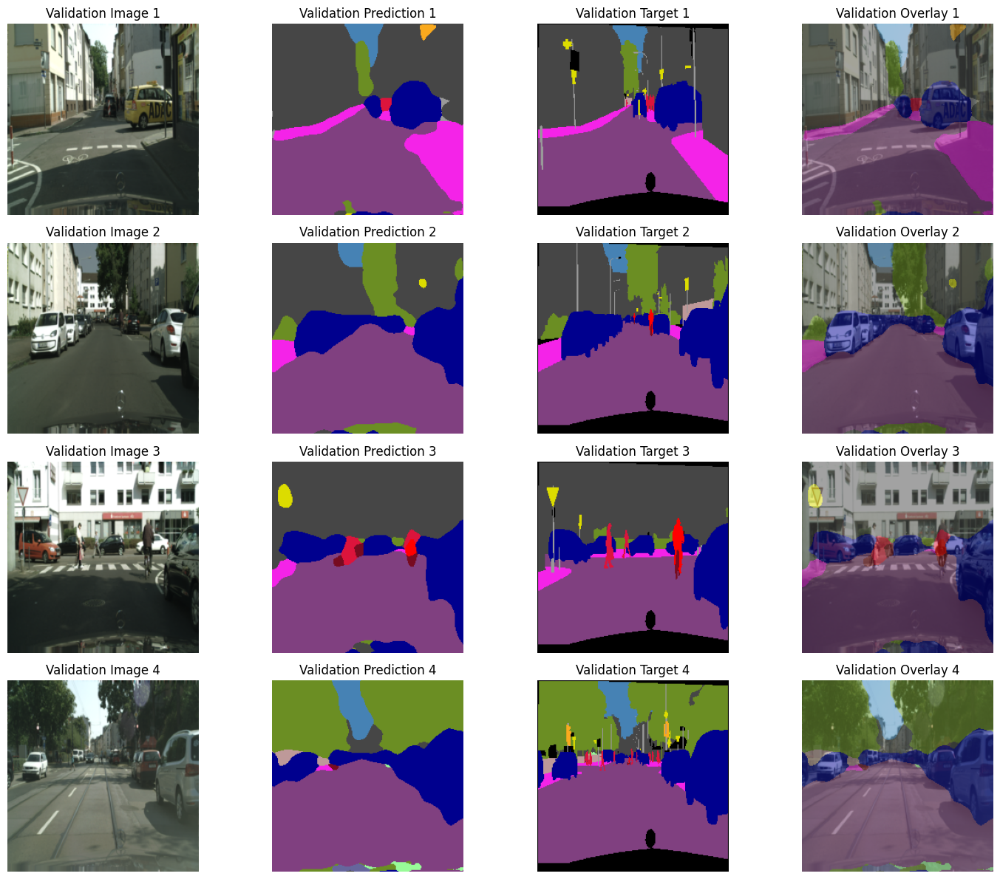

Validation Loss: 0.3471, Validation Accuracy: 77.18%
Checkpoint saved to model/epoch_5_segmentation_checkpoint.pth
Segmentation head saved with best_val_accuracy: 77.1765


Epoch [6/100], Training Loss: 0.2792


Epoch [7/100], Training Loss: 0.2709


Epoch [8/100], Training Loss: 0.2636


Epoch [9/100], Training Loss: 0.2568


Epoch [10/100], Training Loss: 0.2508


Validation Loss: 0.3573, Validation Accuracy: 77.16%


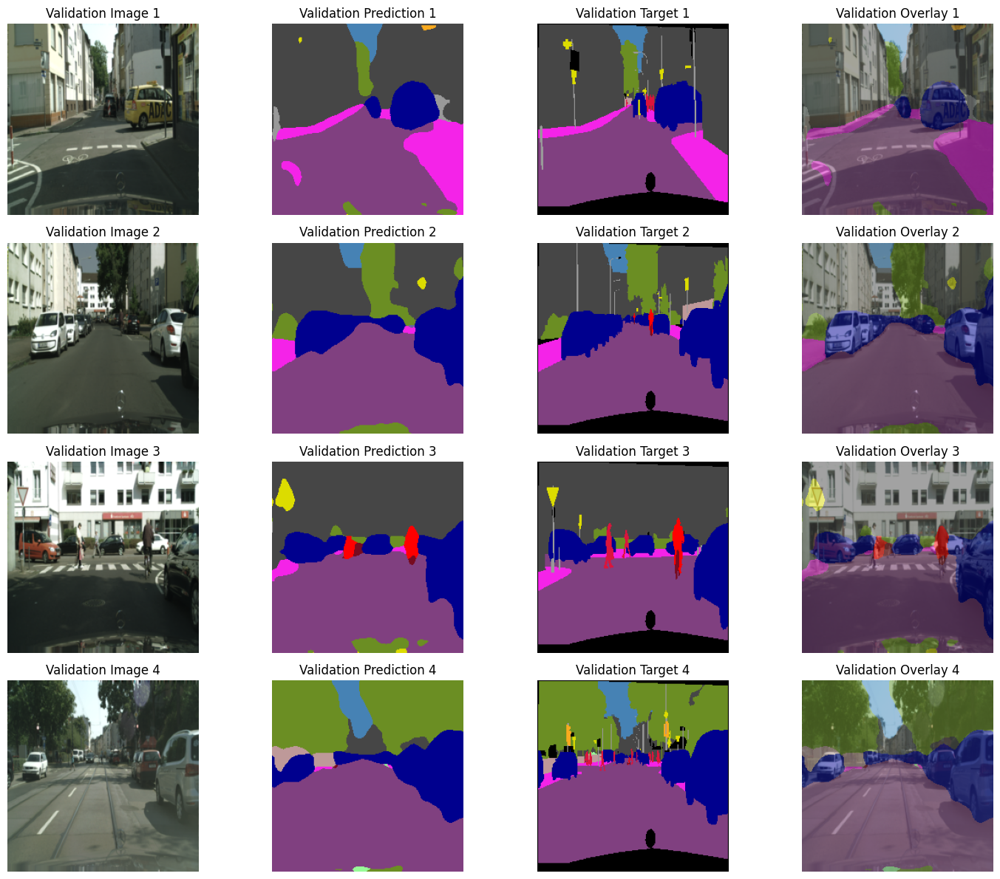

Validation Loss: 0.3573, Validation Accuracy: 77.16%


Epoch [11/100], Training Loss: 0.2470


Epoch [12/100], Training Loss: 0.2420


Epoch [13/100], Training Loss: 0.2366


Epoch [14/100], Training Loss: 0.2336


Epoch [15/100], Training Loss: 0.2291


Validation Loss: 0.3804, Validation Accuracy: 76.97%


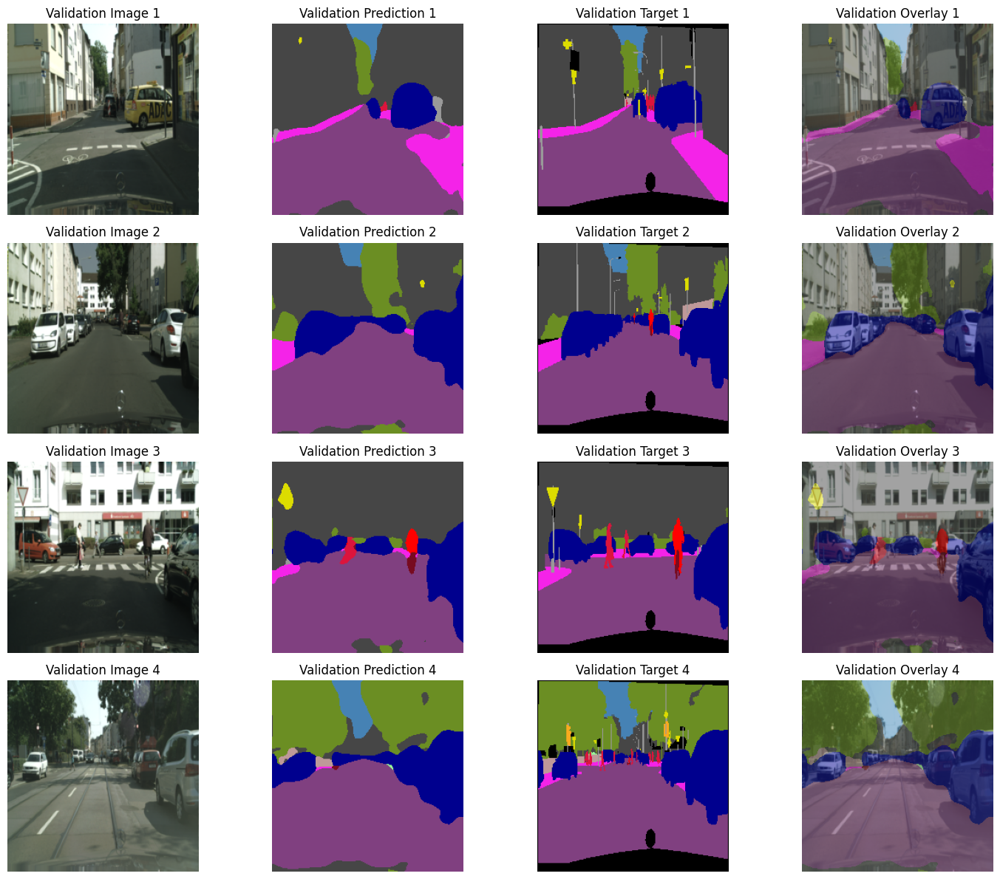

Validation Loss: 0.3804, Validation Accuracy: 76.97%


Epoch [16/100], Training Loss: 0.2266


Epoch [17/100], Training Loss: 0.2232


Epoch [18/100], Training Loss: 0.2201


Epoch [19/100], Training Loss: 0.2174


Epoch [20/100], Training Loss: 0.2143


Validation Loss: 0.3658, Validation Accuracy: 77.16%


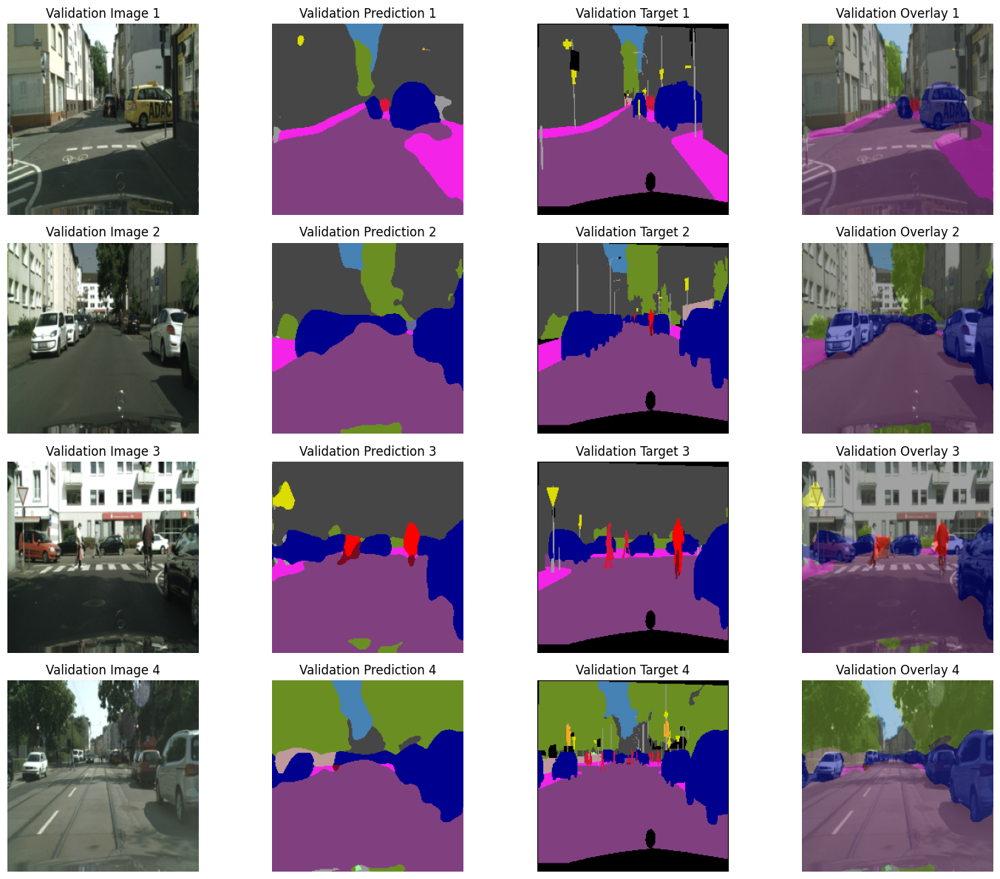

Validation Loss: 0.3658, Validation Accuracy: 77.16%


Epoch [21/100], Training Loss: 0.2134


Epoch [22/100], Training Loss: 0.2098


Epoch [23/100], Training Loss: 0.2080


Epoch [24/100], Training Loss: 0.2061


Epoch [25/100], Training Loss: 0.2039


Validation Loss: 0.3738, Validation Accuracy: 77.19%


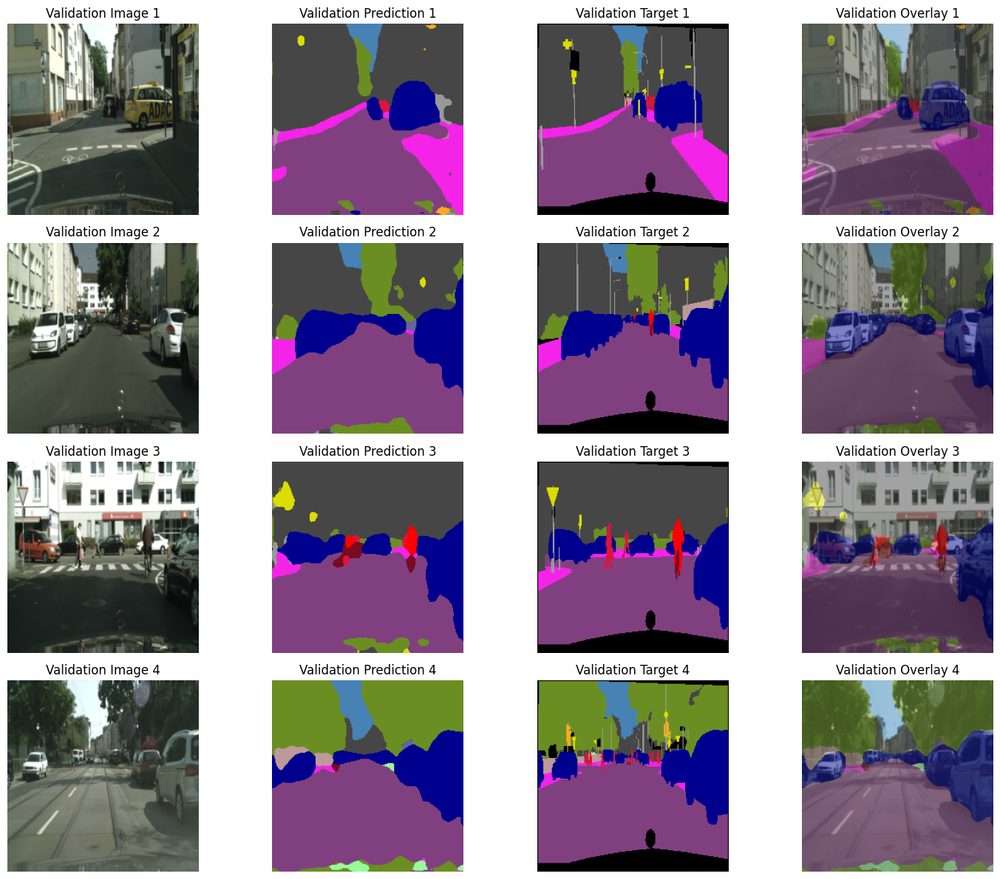

Validation Loss: 0.3738, Validation Accuracy: 77.19%
Checkpoint saved to model/epoch_25_segmentation_checkpoint.pth
Segmentation head saved with best_val_accuracy: 77.1860


Epoch [26/100], Training Loss: 0.2021


Epoch [27/100], Training Loss: 0.1999


Epoch [28/100], Training Loss: 0.1977


Epoch [29/100], Training Loss: 0.1967


Epoch [30/100], Training Loss: 0.1942


Validation Loss: 0.3843, Validation Accuracy: 77.01%


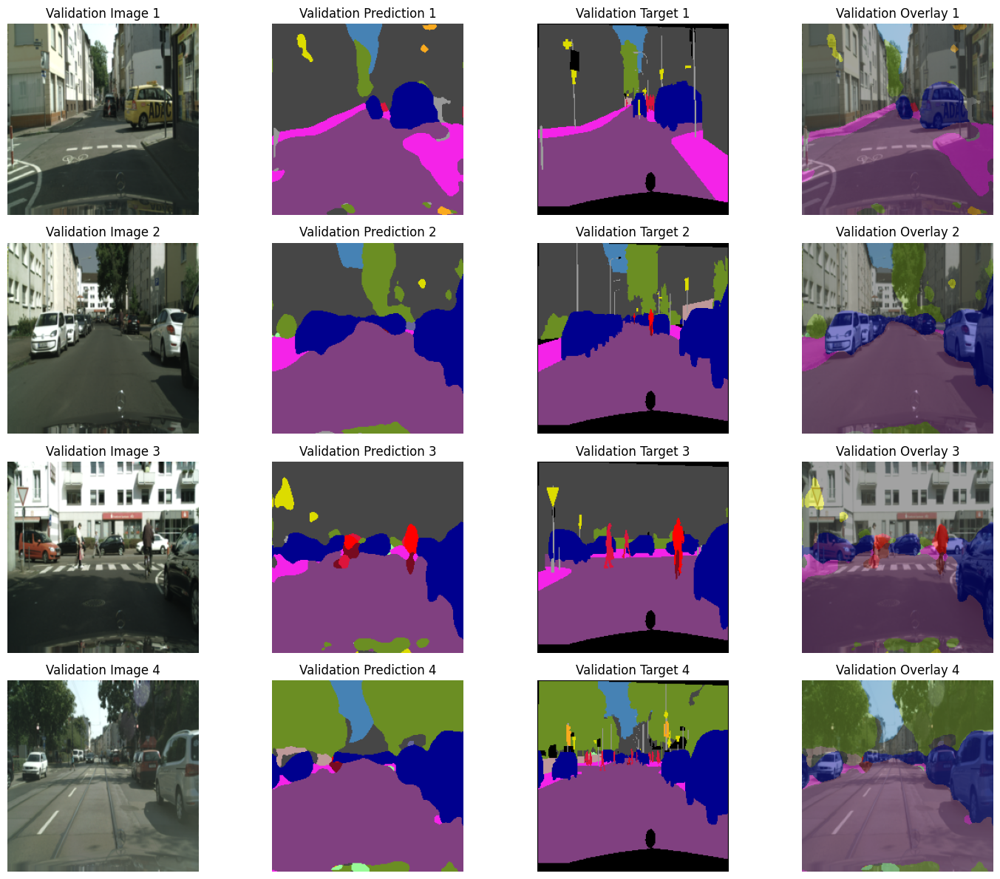

Validation Loss: 0.3843, Validation Accuracy: 77.01%


Epoch [31/100], Training Loss: 0.1947


Epoch [32/100], Training Loss: 0.1923


Epoch [33/100], Training Loss: 0.1912


Epoch [34/100], Training Loss: 0.1892


Epoch [35/100], Training Loss: 0.1879


Validation Loss: 0.3891, Validation Accuracy: 77.01%


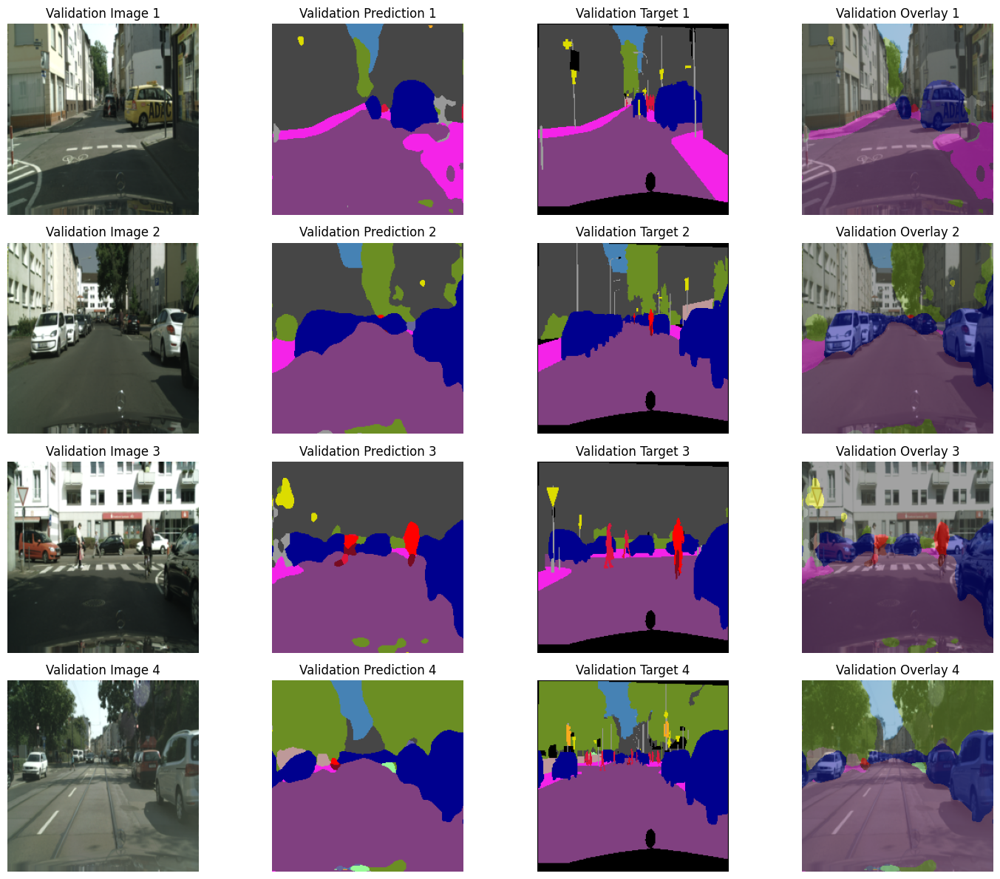

Validation Loss: 0.3891, Validation Accuracy: 77.01%


Epoch [36/100], Training Loss: 0.1875


Epoch [37/100], Training Loss: 0.1886


Epoch [38/100], Training Loss: 0.1843


Epoch [39/100], Training Loss: 0.1829


Epoch [40/100], Training Loss: 0.1820


Validation Loss: 0.3982, Validation Accuracy: 77.05%


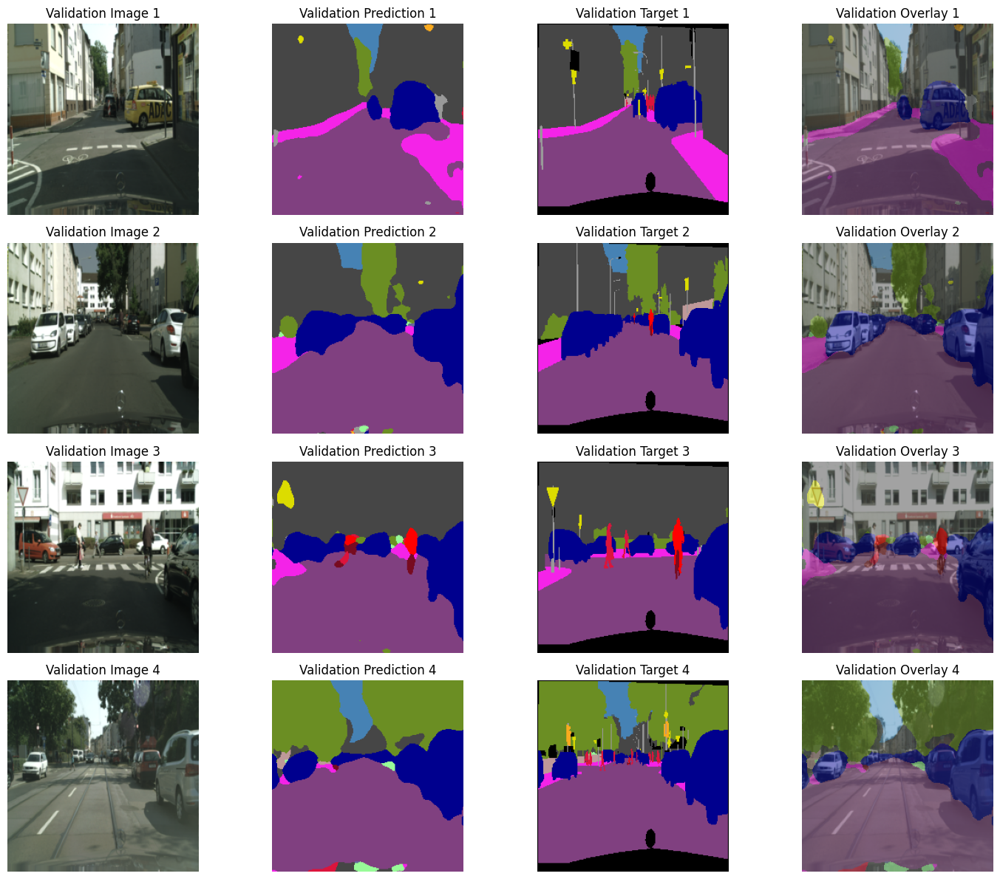

Validation Loss: 0.3982, Validation Accuracy: 77.05%


Epoch [41/100], Training Loss: 0.1821


Epoch [42/100], Training Loss: 0.1811


Epoch [43/100], Training Loss: 0.1798


Epoch [44/100], Training Loss: 0.1792


Epoch [45/100], Training Loss: 0.1781


Validation Loss: 0.3921, Validation Accuracy: 77.12%


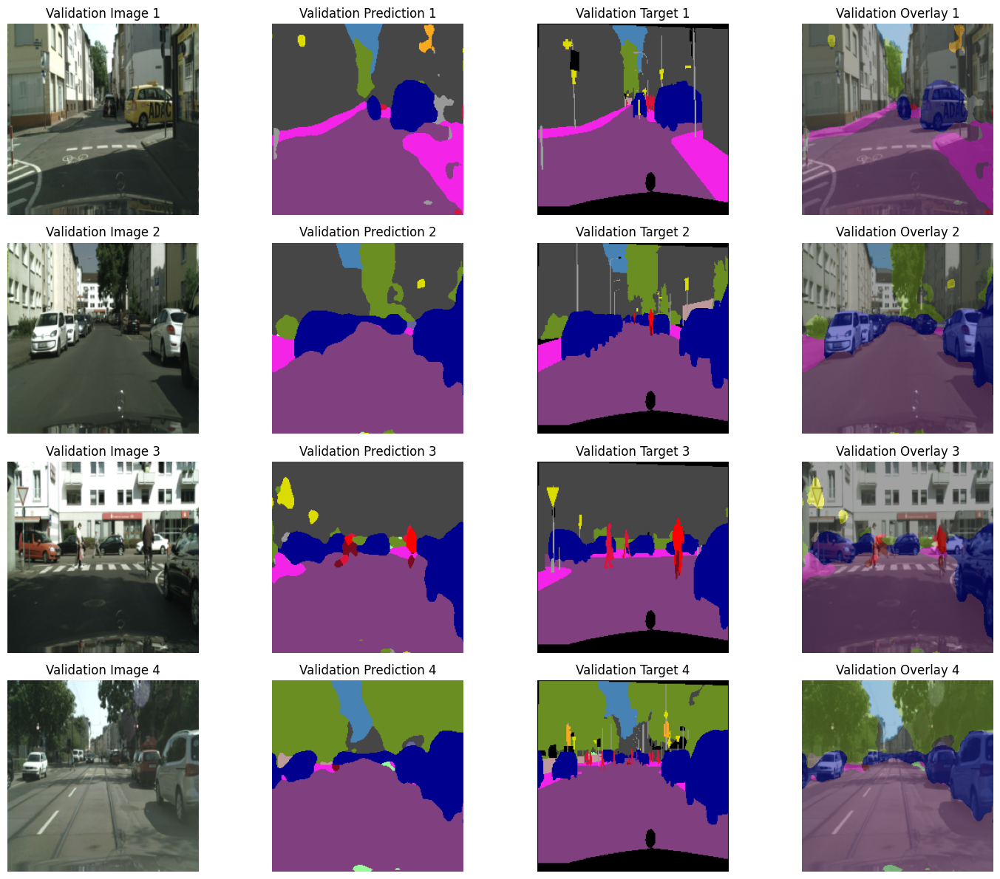

Validation Loss: 0.3921, Validation Accuracy: 77.12%


Epoch [46/100], Training Loss: 0.1781


Epoch [47/100], Training Loss: 0.1770


Epoch [48/100], Training Loss: 0.1758


Epoch [49/100], Training Loss: 0.1745


Epoch [50/100], Training Loss: 0.1751


Validation Loss: 0.4043, Validation Accuracy: 76.88%


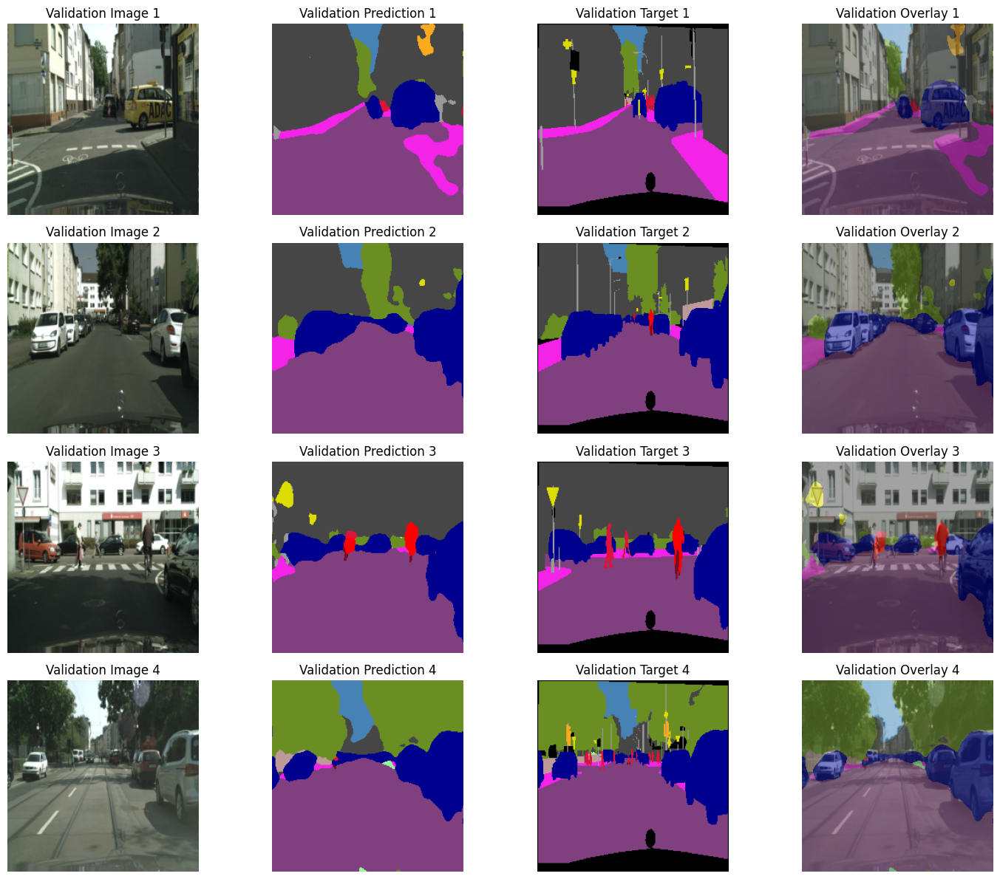

Validation Loss: 0.4043, Validation Accuracy: 76.88%


Epoch [51/100], Training Loss: 0.1752


Epoch [52/100], Training Loss: 0.1722


Epoch [53/100], Training Loss: 0.1716


Epoch [54/100], Training Loss: 0.1719


Epoch [55/100], Training Loss: 0.1711


Validation Loss: 0.3977, Validation Accuracy: 77.05%


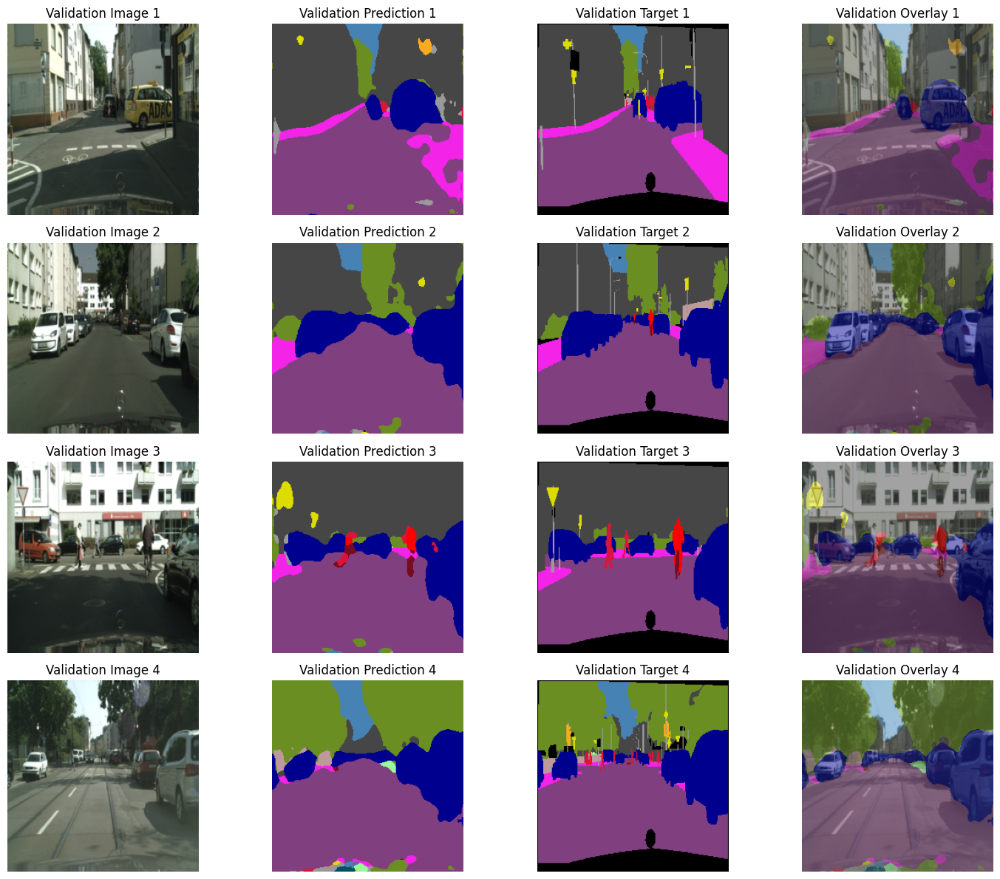

Validation Loss: 0.3977, Validation Accuracy: 77.05%


Epoch [56/100], Training Loss: 0.1704


Epoch [57/100], Training Loss: 0.1693


Epoch [58/100], Training Loss: 0.1693


Epoch [59/100], Training Loss: 0.1682


Epoch [60/100], Training Loss: 0.1684


Validation Loss: 0.4014, Validation Accuracy: 77.08%


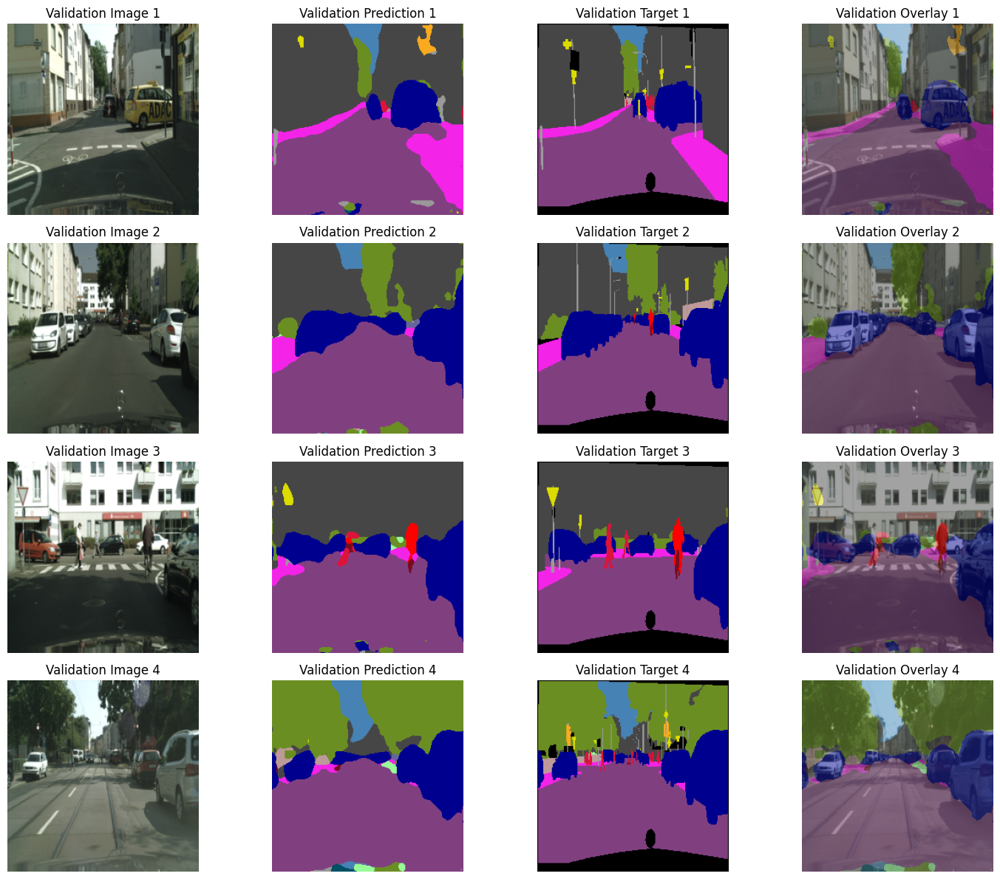

Validation Loss: 0.4014, Validation Accuracy: 77.08%


Epoch [61/100], Training Loss: 0.1678


Epoch [62/100], Training Loss: 0.1670


Epoch [63/100], Training Loss: 0.1670


Epoch [64/100], Training Loss: 0.1656


Epoch [65/100], Training Loss: 0.1655


Validation Loss: 0.4128, Validation Accuracy: 77.00%


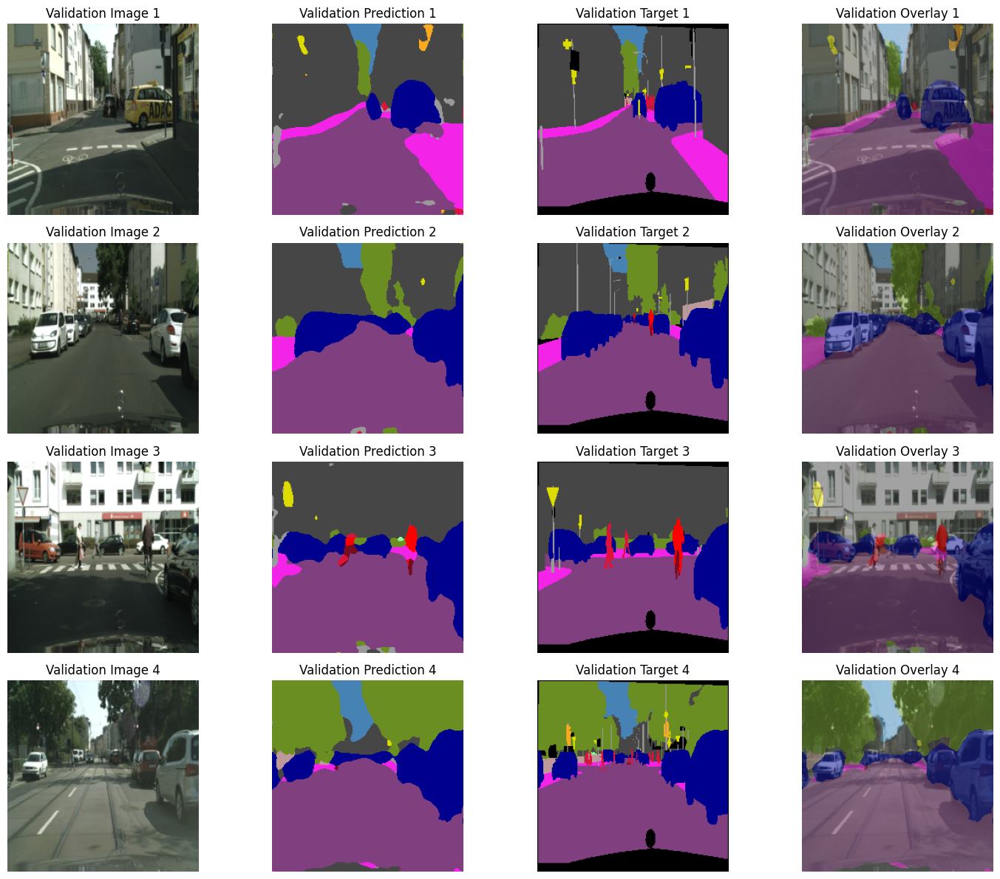

Validation Loss: 0.4128, Validation Accuracy: 77.00%


Epoch [66/100], Training Loss: 0.1646


Epoch [67/100], Training Loss: 0.1647


Epoch [68/100], Training Loss: 0.1647


Epoch [69/100], Training Loss: 0.1638


Epoch [70/100], Training Loss: 0.1630


Validation Loss: 0.4159, Validation Accuracy: 77.03%


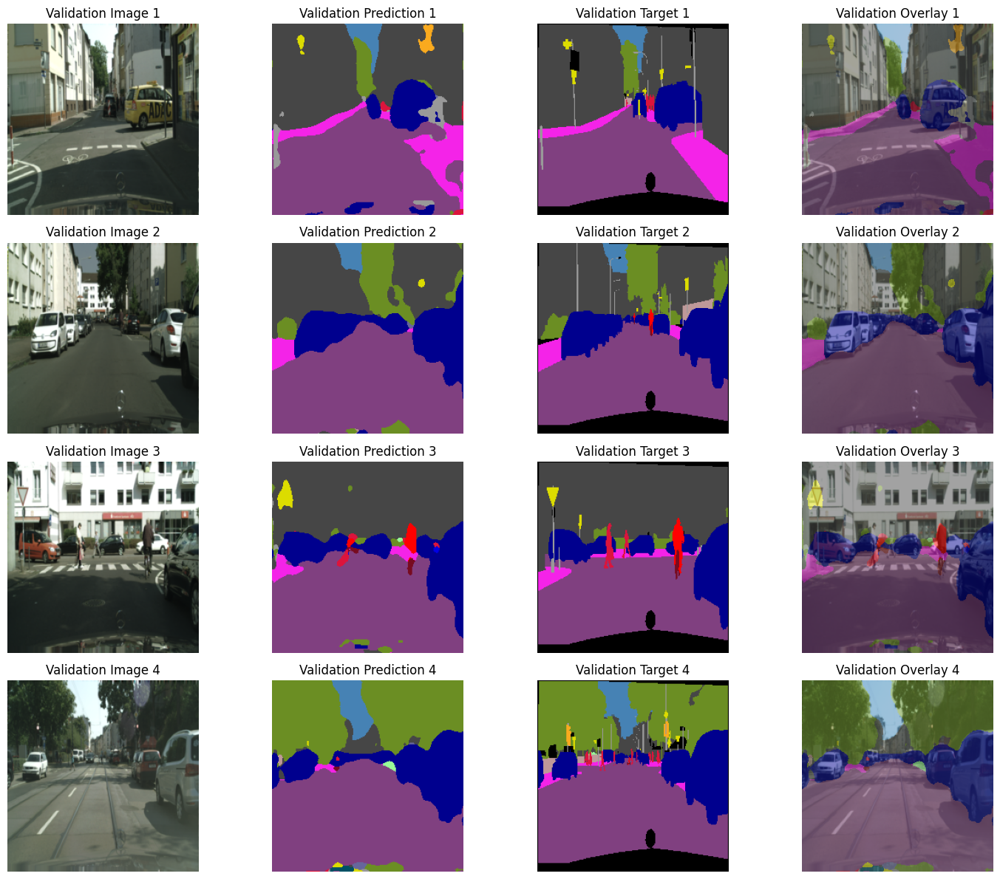

Validation Loss: 0.4159, Validation Accuracy: 77.03%


Epoch [71/100], Training Loss: 0.1618


Epoch [72/100], Training Loss: 0.1630


Epoch [73/100], Training Loss: 0.1619


Epoch [74/100], Training Loss: 0.1614


Epoch [75/100], Training Loss: 0.1607


Validation Loss: 0.4169, Validation Accuracy: 76.97%


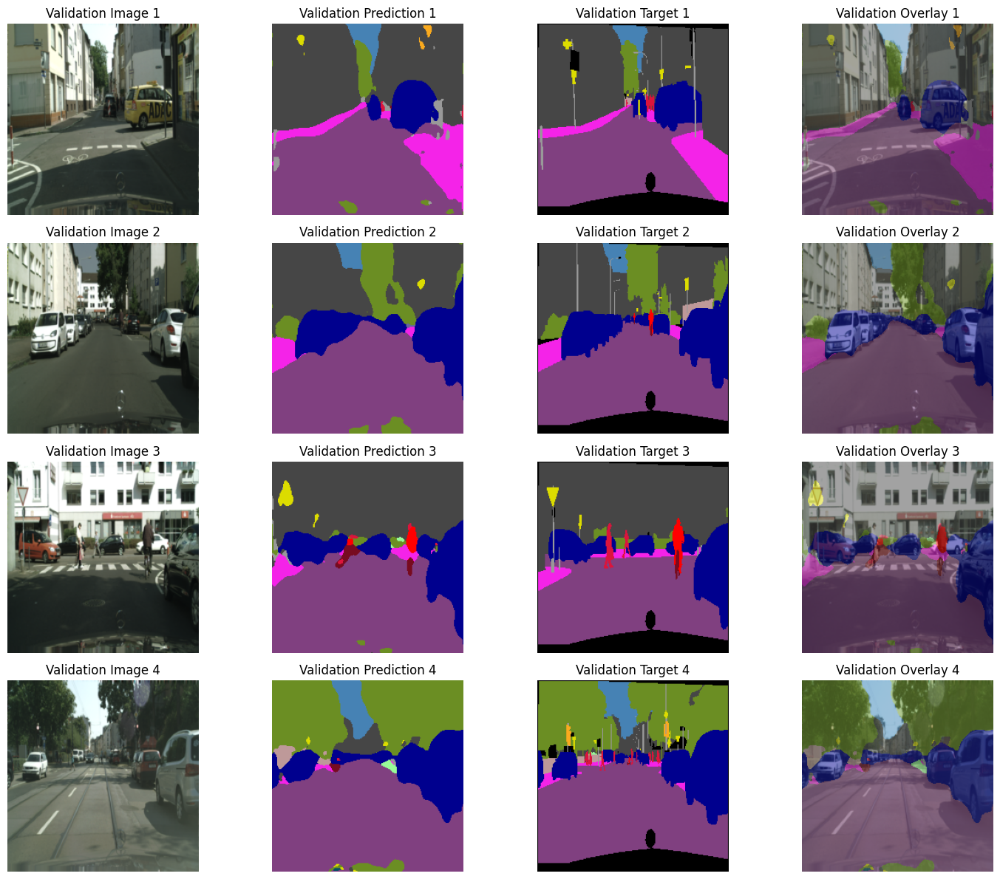

Validation Loss: 0.4169, Validation Accuracy: 76.97%


Epoch [76/100], Training Loss: 0.1604


Epoch [77/100], Training Loss: 0.1608


Epoch [78/100], Training Loss: 0.1594


Epoch [79/100], Training Loss: 0.1591


Epoch [80/100], Training Loss: 0.1591


Validation Loss: 0.4157, Validation Accuracy: 76.95%


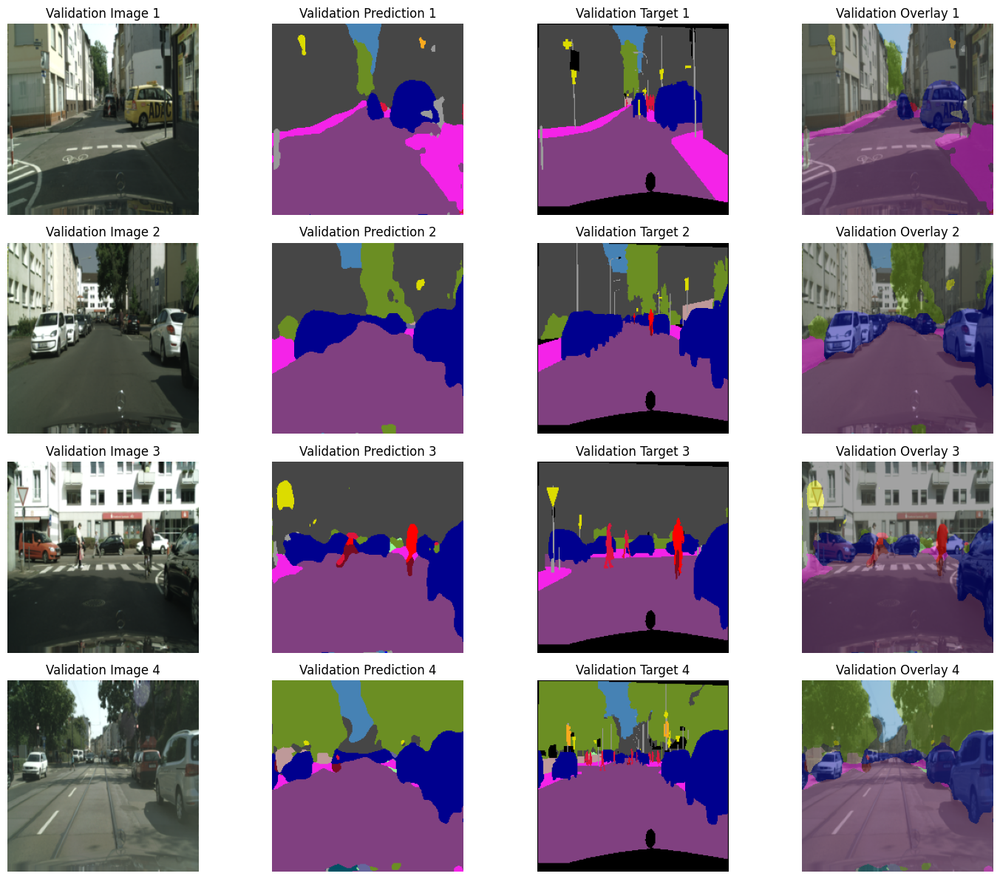

Validation Loss: 0.4157, Validation Accuracy: 76.95%


Epoch [81/100], Training Loss: 0.1599


Epoch [82/100], Training Loss: 0.1582


Epoch [83/100], Training Loss: 0.1578


Epoch [84/100], Training Loss: 0.1585


Epoch [85/100], Training Loss: 0.1574


Validation Loss: 0.4192, Validation Accuracy: 77.00%


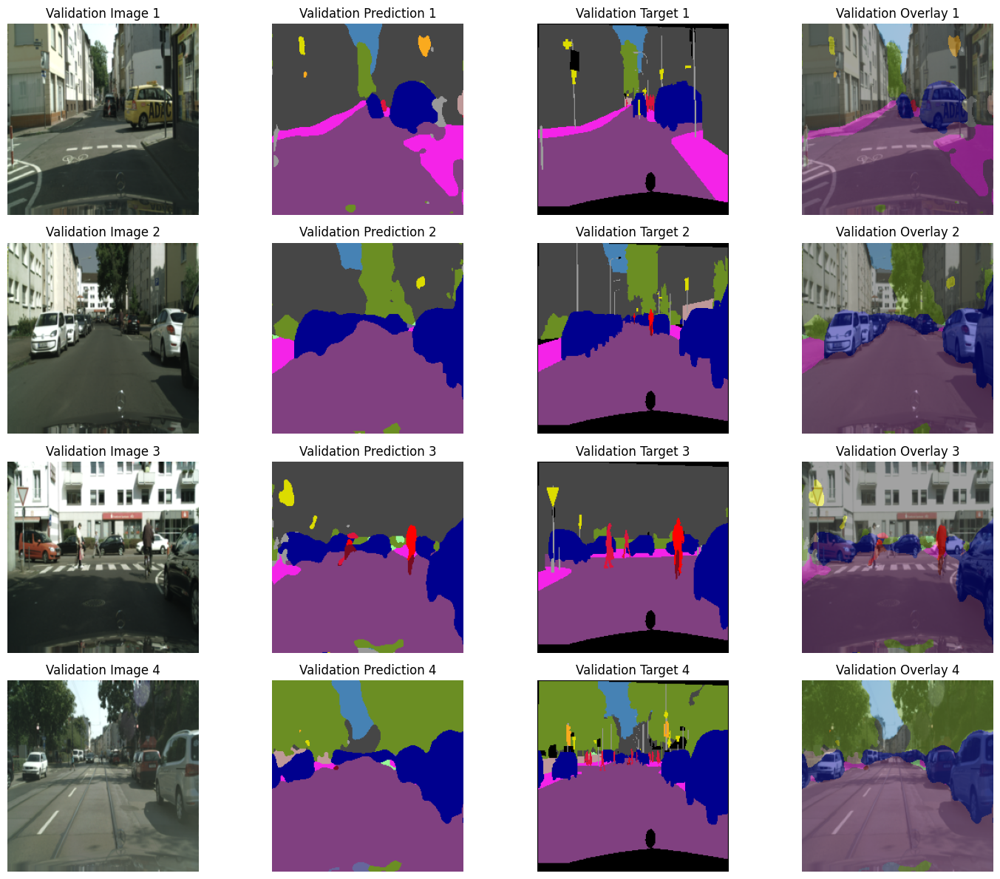

Validation Loss: 0.4192, Validation Accuracy: 77.00%


Epoch [86/100], Training Loss: 0.1574


Epoch [87/100], Training Loss: 0.1568


Epoch [88/100], Training Loss: 0.1566


Epoch [89/100], Training Loss: 0.1569


Epoch [90/100], Training Loss: 0.1567


Validation Loss: 0.4288, Validation Accuracy: 77.00%


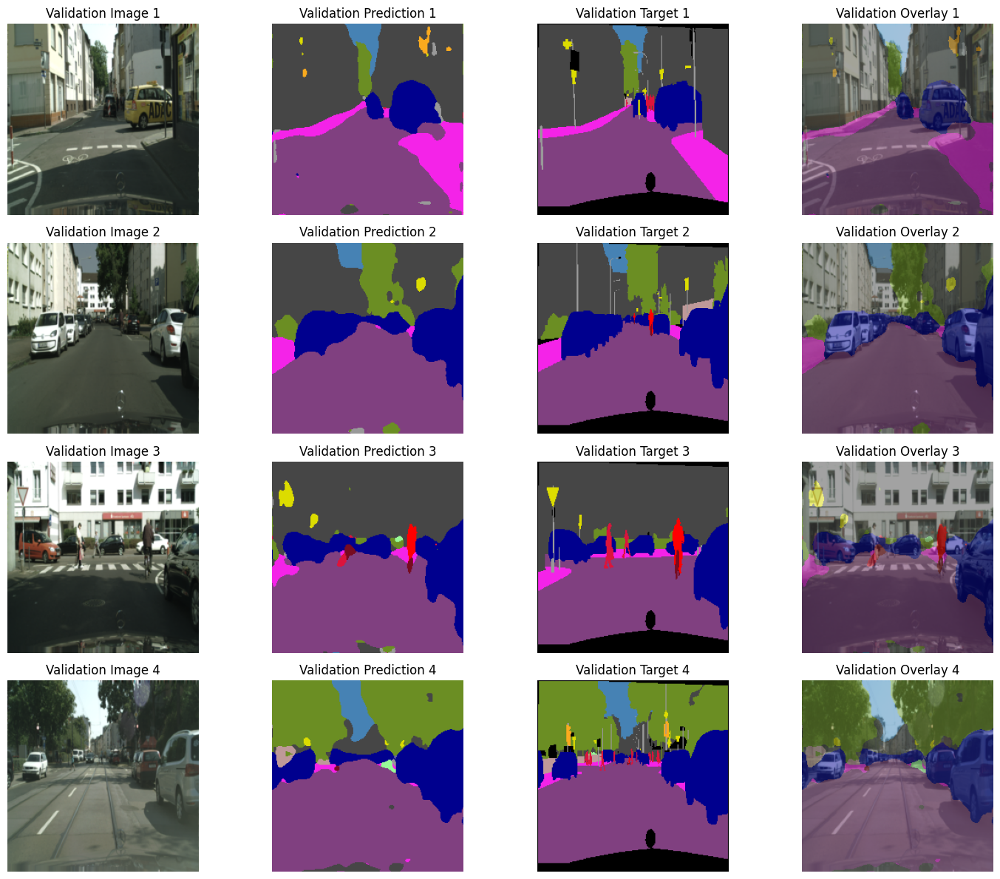

Validation Loss: 0.4288, Validation Accuracy: 77.00%


Epoch [91/100], Training Loss: 0.1552


Epoch [92/100], Training Loss: 0.1549


Epoch [93/100], Training Loss: 0.1558


Epoch [94/100], Training Loss: 0.1554


Epoch [95/100], Training Loss: 0.1546


Validation Loss: 0.4223, Validation Accuracy: 76.97%


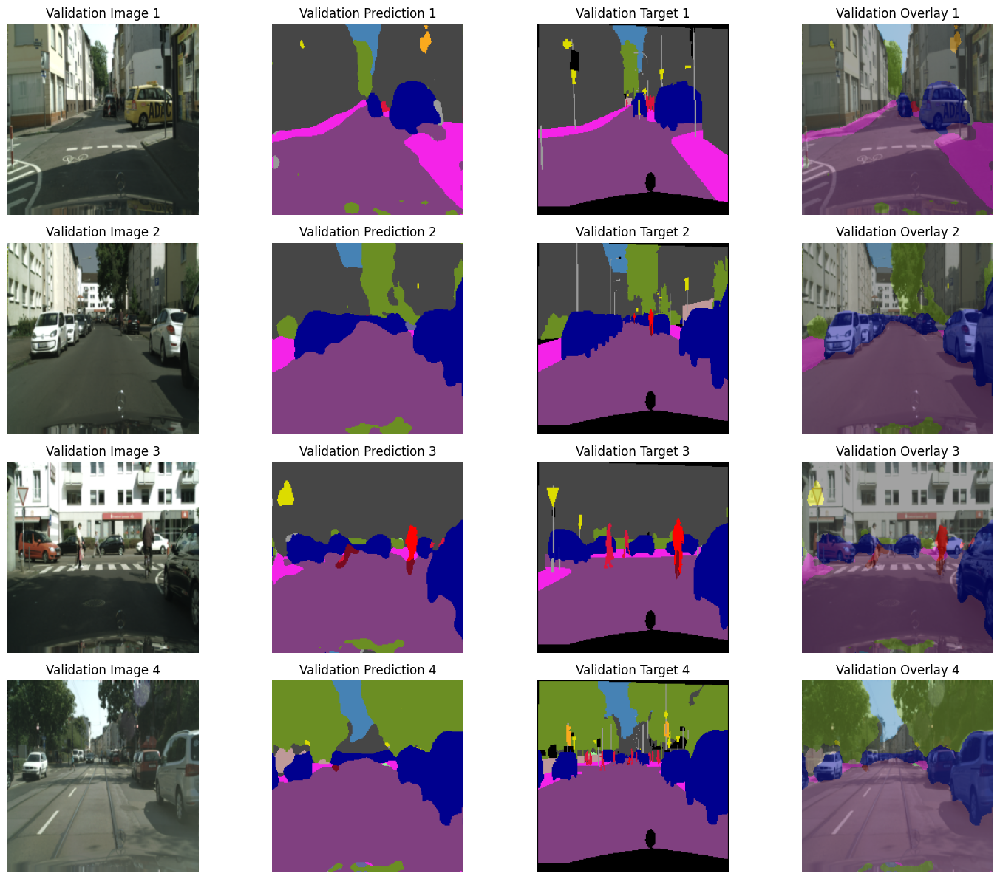

Validation Loss: 0.4223, Validation Accuracy: 76.97%


Epoch [96/100], Training Loss: 0.1541


Epoch [97/100], Training Loss: 0.1537


Epoch [98/100], Training Loss: 0.1537


Epoch [99/100], Training Loss: 0.1533


Epoch [100/100], Training Loss: 0.1527


Validation Loss: 0.4225, Validation Accuracy: 76.90%


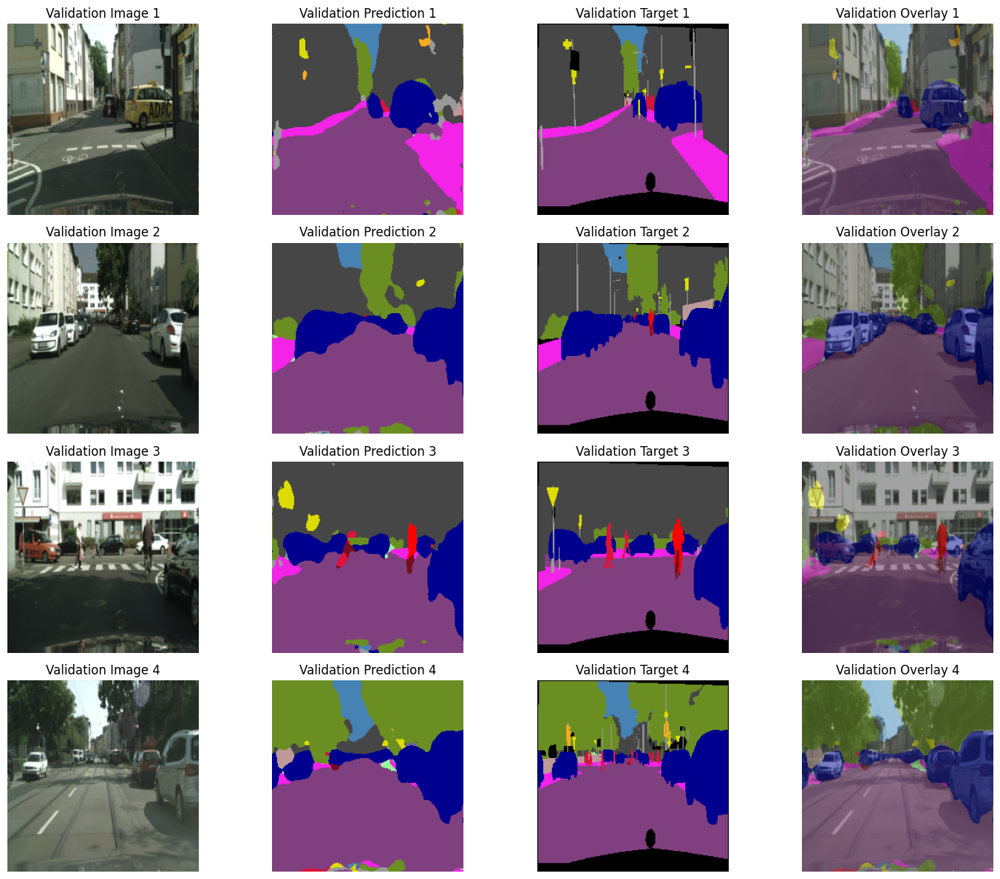

Validation Loss: 0.4225, Validation Accuracy: 76.90%
Final Checkpoint saved to model/epoch_100_segmentation_checkpoint.pth


Test Loss: nan, Test Accuracy: 0.00%


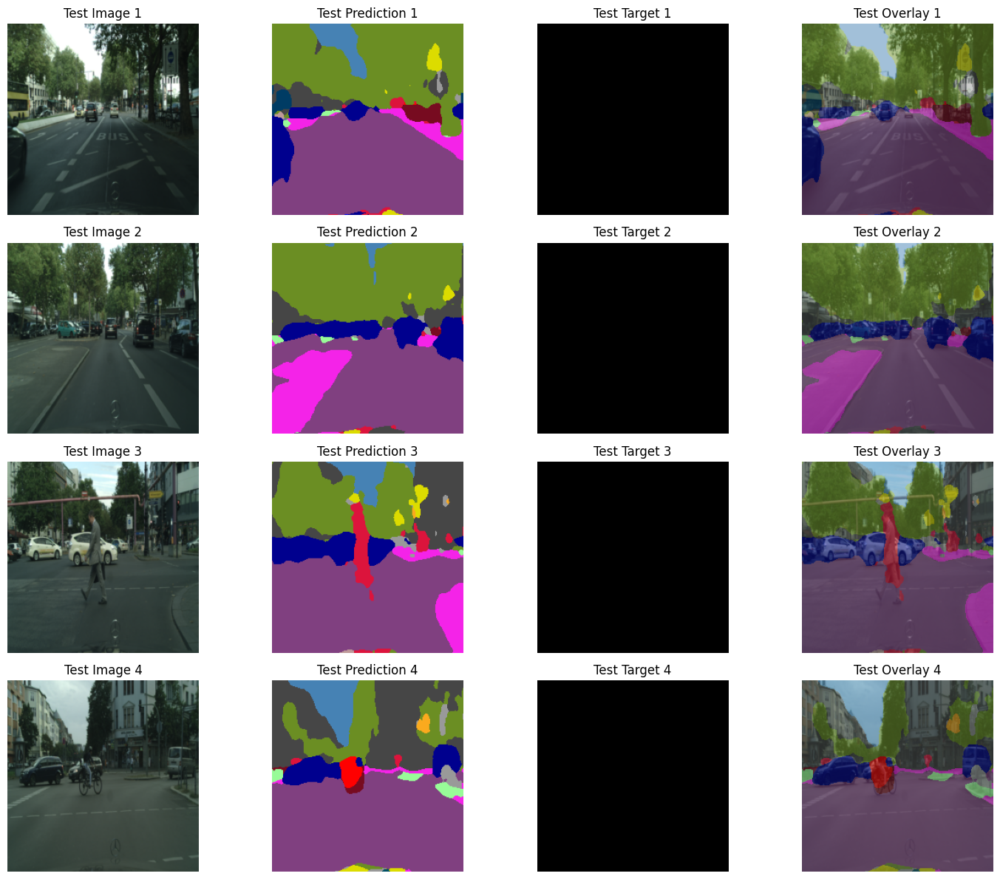

In [51]:
for epoch in range(start_epoch, num_epochs):
    model.train()
    running_loss = 0.0
    progress_bar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}", leave=False, dynamic_ncols=True)

    for batch_idx, (images, targets) in enumerate(progress_bar):
        images, targets = images.to(device), targets.squeeze(1).to(device)
        targets = (targets*255).long()

        # 前向传播
        outputs = model(images)
        loss = criterion(outputs, targets)

        # 反向传播和优化
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * images.size(0)

        # 将训练损失写入 TensorBoard
        writer.add_scalar('Train/Loss', loss.item(), epoch * len(train_loader) + batch_idx)

    epoch_loss = running_loss / len(train_loader.dataset)
    print(f"Epoch [{epoch+1}/{num_epochs}], Training Loss: {epoch_loss:.4f}")

    # 将 epoch 级别的训练损失写入 TensorBoard
    writer.add_scalar('Train/Epoch_Loss', epoch_loss, epoch + 1)

    # 评估验证集
    if (epoch + 1) % 5 == 0:
        val_loss, val_accuracy = evaluate(model, val_loader, criterion, device, phase="validation", num_classes=num_classes)

        # 将验证损失和准确度写入 TensorBoard
        writer.add_scalar('Validation/Loss', val_loss, epoch + 1)
        writer.add_scalar('Validation/Accuracy', val_accuracy, epoch + 1)

        print(f"Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%")

        # 保存分割头权重（如果验证损失是当前最佳）
        if val_accuracy > best_val_accuracy:
            segmentation_checkpoint_path_ = f'model/epoch_{epoch+1}_{segmentation_checkpoint_path}'
            best_val_accuracy = val_accuracy

            checkpoint = {
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'best_val_accuracy': best_val_accuracy
            }
            os.makedirs(checkpoint_dir, exist_ok=True)
            torch.save(checkpoint, segmentation_checkpoint_path_)
            print(f"Checkpoint saved to {segmentation_checkpoint_path_}")

            print(f"Segmentation head saved with best_val_accuracy: {best_val_accuracy:.4f}")
    if epoch == 99:
        segmentation_checkpoint_path_ = f'model/epoch_{epoch+1}_{segmentation_checkpoint_path}'
        checkpoint = {
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
        }
        os.makedirs(checkpoint_dir, exist_ok=True)
        torch.save(checkpoint, segmentation_checkpoint_path_)
        print(f"Final Checkpoint saved to {segmentation_checkpoint_path_}")
# 训练完成后，评估测试集
test_loss, test_accuracy = evaluate(model, test_loader, criterion, device, phase="test", num_classes=num_classes)

# 将测试集结果写入 TensorBoard
writer.add_scalar('Test/Loss', test_loss, num_epochs)
writer.add_scalar('Test/Accuracy', test_accuracy, num_epochs)

# 关闭 TensorBoard writer
writer.close()